# Prepare Dataset and Basic Analysis
## Additional Data `Califolnia`

- Datset I/O Infomation: https://huggingface.co/datasets/chabud-team/chabud-ecml-pkdd2023/tree/main
- California Data: https://huggingface.co/datasets/chabud-team/chabud-extra/tree/main

## Ckeck the missing data


## Overview
1. Load Dataset
2. Save Data with MMseg Format
3. Visualize Satellite Image
4. Cross-validate Image
 

## Import 

In [2]:
import os, glob, random, time, gc
from tqdm import tqdm
from typing import List, Tuple

import numpy as np
import h5py
import pandas as pd
import seaborn as sns
from sklearn.model_selection import KFold
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

SEED = 417
np.random.seed(SEED)
random.seed(SEED)

## Configuration

In [3]:
PATH_ROOT = os.path.join("..", "data")
PATH_DATASET = f"{PATH_ROOT}/train_eval.hdf5"
PATH_CALIFORNIA = [f"{PATH_ROOT}/california_{i}.hdf5" for i in range(5)]
DATASET_NAME = '002_Full+California'
PATH_MMSEG_DATASET = f"{PATH_ROOT}/{DATASET_NAME}/"
NUM_FOLDS = 4

PATH_DATASET, PATH_MMSEG_DATASET, NUM_FOLDS, PATH_CALIFORNIA

('../data/train_eval.hdf5',
 '../data/002_Full+California/',
 4,
 ['../data/california_0.hdf5',
  '../data/california_1.hdf5',
  '../data/california_2.hdf5',
  '../data/california_3.hdf5',
  '../data/california_4.hdf5'])

## Func
from official: https://huggingface.co/datasets/chabud-team/chabud-ecml-pkdd2023/blob/main/loader.py

- Numpy int32: https://numpy.org/doc/stable/user/basics.types.html
- Python Int: https://qiita.com/gomasa/items/f6337087988685d00ebb

Int 32Bit Max: `2147483647`

In [4]:
def loader(
    hdf5_file: str, DEBUG:bool=False
) -> Tuple[np.ndarray, np.ndarray, np.ndarray, List[str]]:
    post = []
    pre = []
    masks = []
    names = []
    folds = []
    hights = []
    widths = []
    is_calfornia = []
    defects = []

    # Read hdf5 file and filter by fold
    with h5py.File(hdf5_file, "r") as f:
        for uuid, values in tqdm(f.items()):                
            
            post_img = values["post_fire"][...]
            post.append(post_img)
            
            if 'fold' in dict(values.attrs).keys():
                folds.append(values.attrs['fold'])
            else:
                folds.append(-1)
            
            if "pre_fire" not in values:
                pre.append(np.zeros(post_img.shape, dtype=post_img.dtype))
                defects.append(True)
            else:
                pre.append(values["pre_fire"][...])
                defects.append(False)
            
            if 'california_' in hdf5_file:
                masks.append(values["mask"][0])
                is_calfornia.append(True)
            else:
                # train_eval.hdf5
                masks.append(values["mask"][:, :, 0])
                is_calfornia.append(False)
                
            names.append(uuid)
            H, W, _ = post_img.shape
            hights.append(H)
            widths.append(W)
            
            if DEBUG:
                print(values.keys(), uuid)
                break

    # Convert to numpy arrays
    post = np.stack(post, axis=0, dtype=np.int32)
    pre = np.stack(pre, axis=0, dtype=np.int32)
    masks = np.stack(masks, axis=0, dtype=np.int32)

    return post, pre, masks, names, folds, hights, widths, is_calfornia, defects

for hdf5_file in PATH_CALIFORNIA + [PATH_DATASET]:
    # DEBUG
    (img_post, img_pre, mask, names, folds, hights, widths, is_calfornias, defects) = loader(
        hdf5_file=hdf5_file, DEBUG=True)

    # size check
    print(img_post.shape, img_pre.shape, mask.shape) # 12 channel 512x512 size

    # data type check
    print(img_post.dtype, img_pre.dtype, mask.dtype) # int32

    print(folds, hights, widths)

  0%|          | 0/399 [00:00<?, ?it/s]


<KeysViewHDF5 ['mask', 'post_fire', 'pre_fire']> cdd9e3a0-5030-49a8-ab76-4469381ee966_0
(1, 512, 512, 12) (1, 512, 512, 12) (1, 512, 512)
int32 int32 int32
[-1] [512] [512]


  0%|          | 0/400 [00:00<?, ?it/s]


<KeysViewHDF5 ['mask', 'post_fire', 'pre_fire']> d38ad371-6c7b-4780-8f9f-e503d784f2ed_27
(1, 512, 512, 12) (1, 512, 512, 12) (1, 512, 512)
int32 int32 int32
[-1] [512] [512]


  0%|          | 0/39 [00:00<?, ?it/s]


<KeysViewHDF5 ['mask', 'post_fire', 'pre_fire']> e0f11e18-eed0-4eee-972e-6955c2024c19_64
(1, 512, 512, 12) (1, 512, 512, 12) (1, 512, 512)
int32 int32 int32
[-1] [512] [512]


  0%|          | 0/399 [00:00<?, ?it/s]


<KeysViewHDF5 ['mask', 'post_fire', 'pre_fire']> 3c89a5f6-9fb6-4ec8-b4e7-e073f356f7b2_0
(1, 512, 512, 12) (1, 512, 512, 12) (1, 512, 512)
int32 int32 int32
[-1] [512] [512]


  0%|          | 0/194 [00:00<?, ?it/s]

<KeysViewHDF5 ['mask', 'post_fire', 'pre_fire']> 483143d9-7abb-4791-a64e-cceea6f1263d_32
(1, 512, 512, 12) (1, 512, 512, 12) (1, 512, 512)
int32 int32 int32
[-1] [512] [512]



  0%|          | 0/534 [00:00<?, ?it/s]

<KeysViewHDF5 ['mask', 'post_fire', 'pre_fire']> 012b8863-976c-44e1-a491-9adf19c1cbba_0
(1, 512, 512, 12) (1, 512, 512, 12) (1, 512, 512)
int32 int32 int32
[1] [512] [512]


## Save the MMseg Format
- `img`
- `ann`

    same file name pare 

In [5]:
for _D in ['img', 'ann']:
    _PATH = os.path.join(PATH_MMSEG_DATASET, _D)
    print(_PATH)
    
    if not os.path.exists(_PATH):
        os.makedirs(_PATH)

../data/002_Full+California/img
../data/002_Full+California/ann


In [6]:
DEBUG = False

path_imgs, path_masks = [], []
HIGHTS, WIDTHS = [], []
NAMES, FOLDS = [], []
IS_CALIFORNIAS = []
DEFETS = []

positive_ratios, post_missings, pre_missings = [], [], []

for hdf5_file in PATH_CALIFORNIA + [PATH_DATASET]:
    
    img_post, img_pre, mask, names, folds, hights, widths, is_calfornias, defects = loader(
    hdf5_file=hdf5_file, DEBUG=DEBUG)
    
    HIGHTS.extend(hights)
    WIDTHS.extend(widths)
    FOLDS.extend(folds)
    NAMES.extend(names)
    IS_CALIFORNIAS.extend(is_calfornias)
    DEFETS.extend(defects)
    
    # Duplicate name check
    num_unique = len(set(names))
    print('NUM unique names:', num_unique)
    assert num_unique == len(names), 'is Duplicated!!'

    # save feature
    for (post, pre, mask, name, defect) in tqdm(zip(img_post, img_pre, mask, names, defects), total=len(names)):
        
        
        if defect:
            features = np.concatenate([post, post], axis=2) # H, W, C:24
        else:        
            features = np.concatenate([post, pre], axis=2) # H, W, C:24
            
        ratio = np.sum(mask) / (mask.shape[0] * mask.shape[1])
        positive_ratios.append(ratio)
        
        post_missing = np.sum(post).item() == 0.
        post_missings.append(post_missing)
        
        pre_missing = np.sum(pre).item() == 0.
        pre_missings.append(pre_missing)        
        
        # save image
        _PATH_IMG = os.path.join(PATH_MMSEG_DATASET, 'img', name+'.npy')
        path_imgs.append(_PATH_IMG)
        if not os.path.exists(_PATH_IMG):
            np.save(_PATH_IMG, features)
        
        # save annotation
        _PATH_ANN = os.path.join(PATH_MMSEG_DATASET, 'ann', name+'.npy')
        path_masks.append(_PATH_ANN)
        if not os.path.exists(_PATH_ANN):
            np.save(_PATH_ANN, mask) # H, W, C:1
        
        if DEBUG:
            print(_PATH_IMG, _PATH_ANN, features.shape, mask.shape, sep='\n')
            break

100%|██████████| 399/399 [00:29<00:00, 13.55it/s]


NUM unique names: 399


100%|██████████| 400/400 [00:29<00:00, 13.40it/s]


NUM unique names: 400


100%|██████████| 39/39 [00:02<00:00, 15.10it/s]


NUM unique names: 39


100%|██████████| 399/399 [00:38<00:00, 10.46it/s]


NUM unique names: 399


100%|██████████| 194/194 [00:21<00:00,  9.23it/s]


NUM unique names: 194


100%|██████████| 534/534 [00:35<00:00, 15.07it/s]


NUM unique names: 534


100%|██████████| 534/534 [00:03<00:00, 136.82it/s]


In [7]:
df = pd.DataFrame({
    'name': NAMES,
    'feature': path_imgs,
    'mask': path_masks,
    'defects': DEFETS,
    'fold': FOLDS,
    'hight' : HIGHTS,
    'width': WIDTHS,
    'california': IS_CALIFORNIAS,
    'pre_missing': pre_missings,
    'post_missing': post_missings,
    'ratio': positive_ratios,
})
df.head(3)

,name,feature,mask,defects,fold,hight,width,california,pre_missing,post_missing,ratio
0,cdd9e3a0-5030-49a8-ab76-4469381ee966_0,../data/002_Full+California/img/cdd9e3a0-5030-...,../data/002_Full+California/ann/cdd9e3a0-5030-...,False,-1,512,512,True,False,False,0.0
1,cdd9e3a0-5030-49a8-ab76-4469381ee966_1,../data/002_Full+California/img/cdd9e3a0-5030-...,../data/002_Full+California/ann/cdd9e3a0-5030-...,False,-1,512,512,True,False,False,0.0
2,cdd9e3a0-5030-49a8-ab76-4469381ee966_10,../data/002_Full+California/img/cdd9e3a0-5030-...,../data/002_Full+California/ann/cdd9e3a0-5030-...,False,-1,512,512,True,False,False,0.0


In [8]:
df_sub = df[(df['fold'] == 0) & (df['defects'] == False)]
df_sub.describe()

,fold,hight,width,ratio
count,78.0,78.0,78.0,78.000000
mean,0.0,512.0,512.0,0.138647
std,0.0,0.0,0.0,0.252807
min,0.0,512.0,512.0,0.000042
25%,0.0,512.0,512.0,0.002700
50%,0.0,512.0,512.0,0.017540
75%,0.0,512.0,512.0,0.103713
max,0.0,512.0,512.0,1.000000


## Visualize

Sentinel-2 Band: https://www.restec.or.jp/satellite/sentinel-2-a-2-b.html

- Inconsistent resolution

<Axes: xlabel='count', ylabel='defects'>

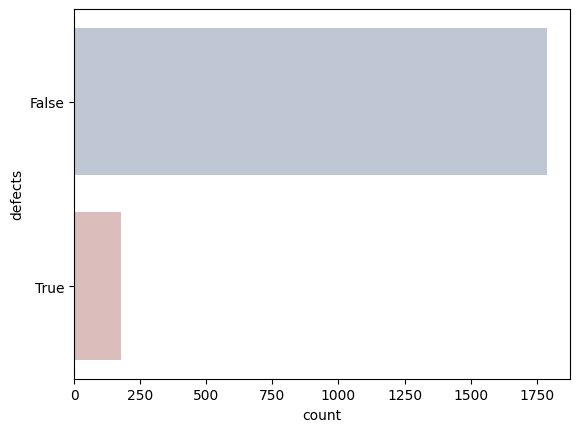

In [9]:
sns.countplot(y='defects', palette="vlag", data=df)

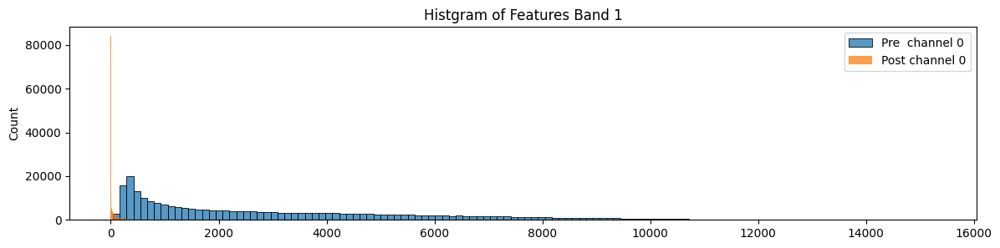

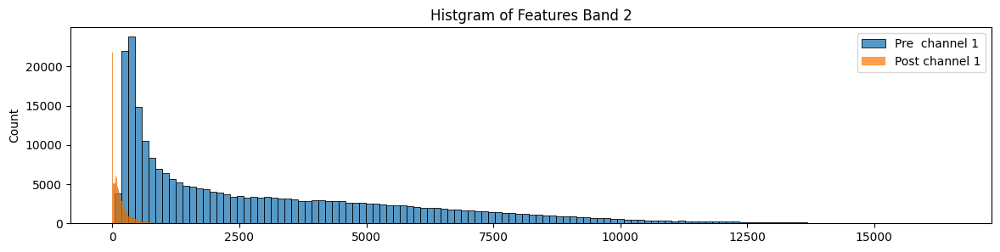

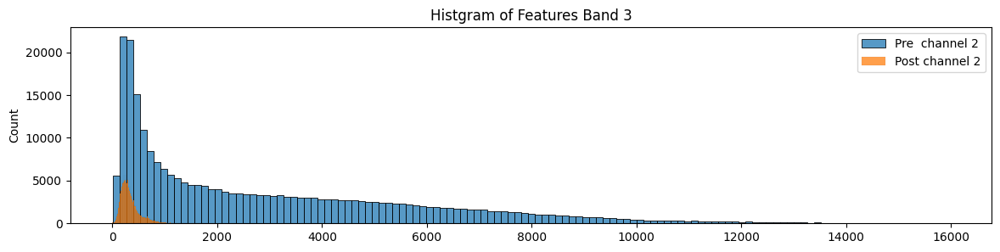

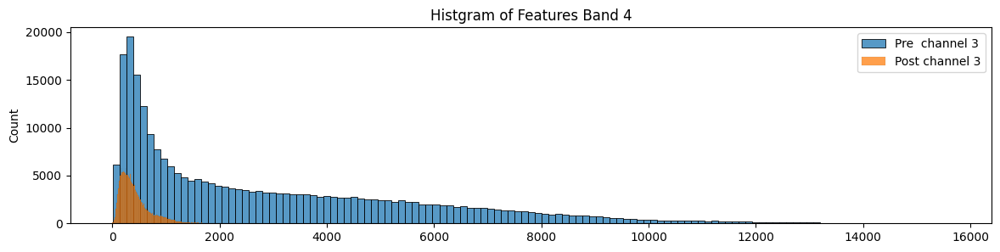

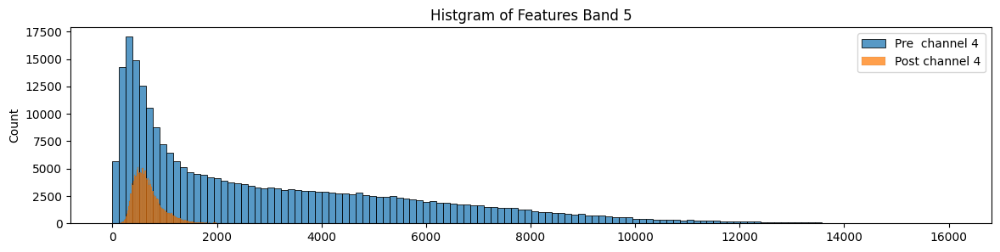

...

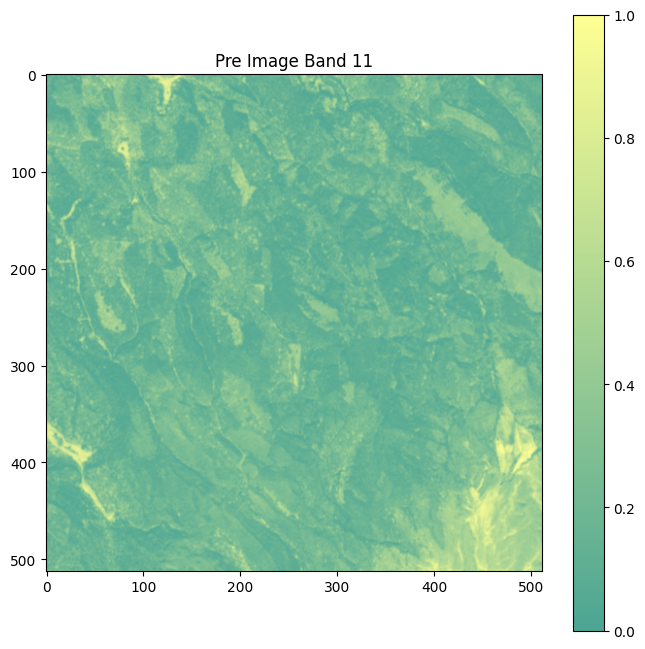

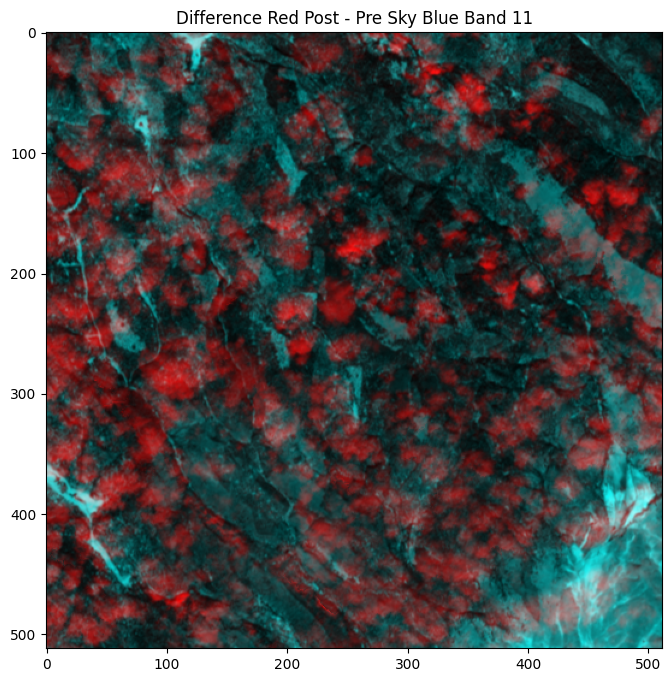

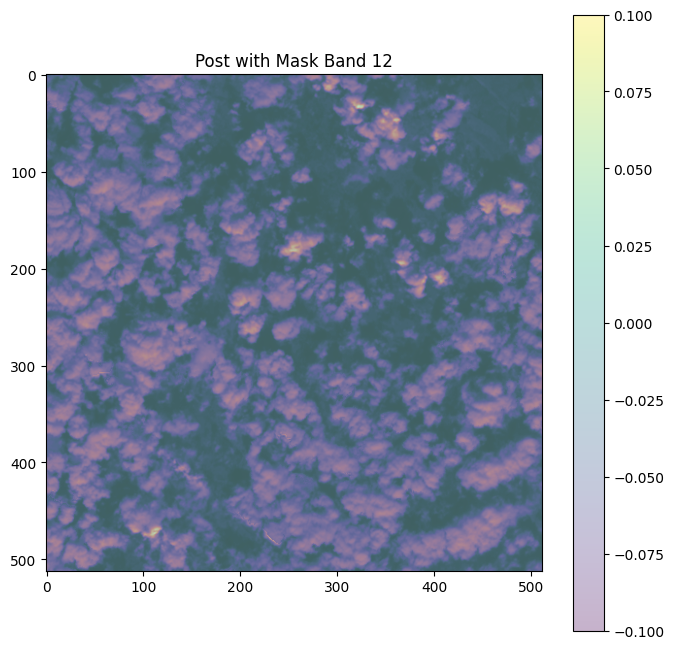

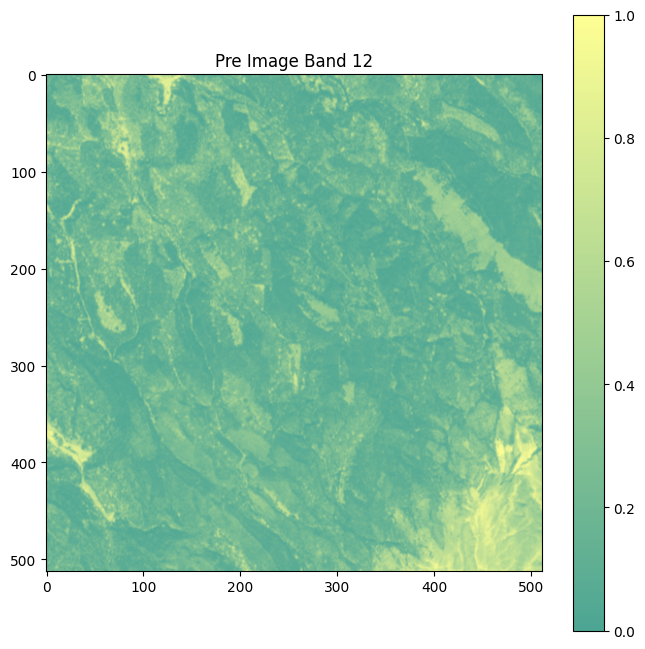

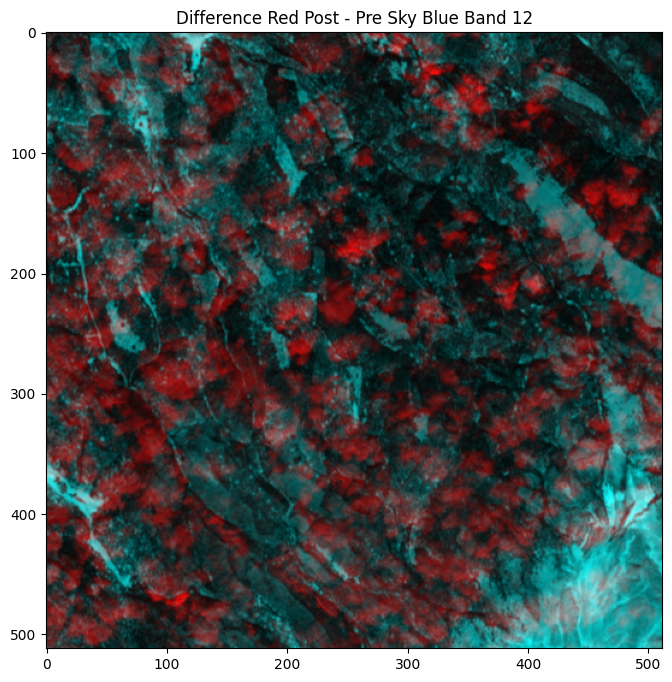

In [10]:
IDX = 1


PATH_IMG = df['feature'].iloc[IDX]
PATH_MSK = PATH_IMG.replace('img', 'ann')

features = np.load(PATH_IMG).astype(np.float32)
mask = np.load(PATH_MSK).astype(np.float32)

for num_band in range(12):
    plt.figure(figsize=(14, 3))
    plt.title(f'Histgram of Features Band {num_band+1}')
    sns.histplot(features[:, :, num_band].flatten(), label=f'Pre  channel {num_band}', )
    sns.histplot(features[:, :, num_band+12].flatten(), label=f'Post channel {num_band}', )
    plt.legend(loc='upper right')
    plt.show();

# minmax scale by band
for _c in range(12):
    features[:, :, _c] = (features[:, :, _c] - features[:, :, _c].min()) / (features[:, :, _c].max() - features[:, :, _c].min())
    features[:, :, _c+12] = (features[:, :, _c+12] - features[:, :, _c+12].min()) / (features[:, :, _c+12].max() - features[:, :, _c+12].min())
    
    plt.figure(figsize=(8, 8))
    plt.title(f'Post with Mask Band {_c+1}')
    plt.imshow(features[:, :, _c], alpha=0.7, cmap='magma')
    plt.imshow(mask, alpha=0.3)
    plt.colorbar()
    plt.show();
    
    plt.figure(figsize=(8, 8))
    plt.title(f'Pre Image Band {_c+1}')
    plt.imshow(features[:, :, _c+12], alpha=0.7, cmap='summer')
    plt.colorbar()
    plt.show();
    
    plt.figure(figsize=(8, 8))
    plt.title(f'Difference Red Post - Pre Sky Blue Band {_c+1}')
    plt.imshow(np.stack([features[:, :, _c], features[:, :, _c+12], features[:, :, _c+12]], axis=2))
    plt.show();
    
plt.clf()
plt.close()

## CV

<Axes: xlabel='cv', ylabel='count'>

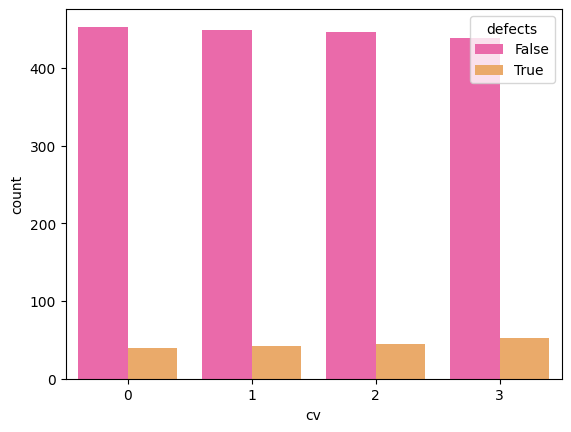

In [11]:
n_fold = np.zeros(len(df["name"]))
kf = KFold(n_splits=NUM_FOLDS, random_state=SEED, shuffle=True)
for k, (_, val_idx) in enumerate(kf.split(np.array(range(len(df["name"]))))):
    n_fold[val_idx] = k

df["cv"] = n_fold.astype(np.uint8)

sns.countplot(x='cv', palette="spring", data=df, hue='defects')

<Axes: xlabel='fold', ylabel='count'>

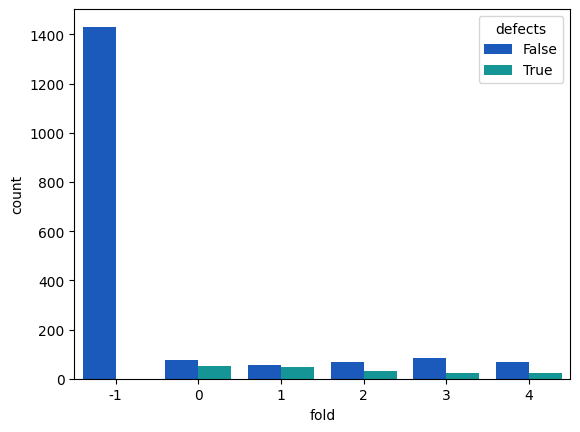

In [12]:
sns.countplot(x='fold', palette="winter", data=df, hue='defects', )

<Axes: xlabel='count', ylabel='california'>

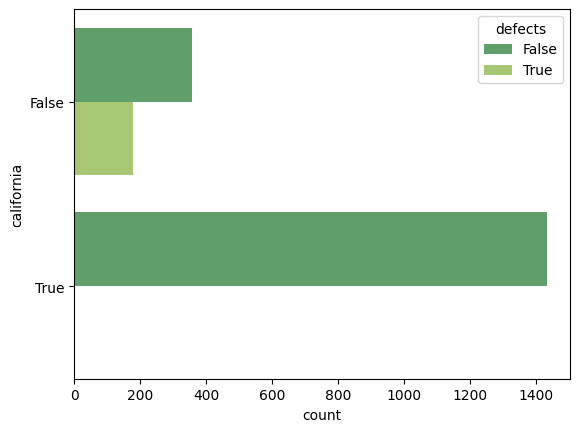

In [13]:
sns.countplot(y='california', palette="summer", data=df, hue='defects')

<Axes: xlabel='ratio', ylabel='Count'>

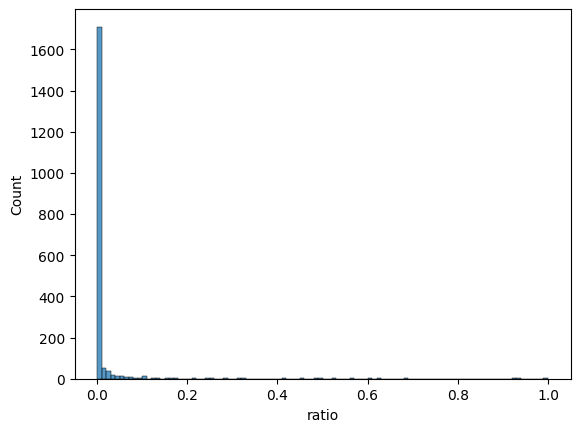

In [22]:
sns.histplot(data=df, x="ratio", bins=100)

<Axes: xlabel='pre_missing', ylabel='count'>

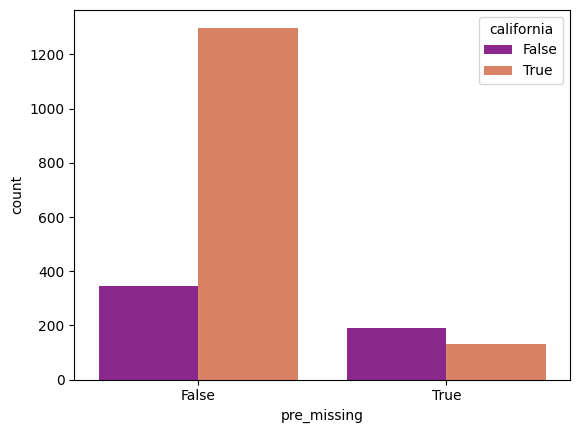

In [23]:
sns.countplot(x='pre_missing', palette="plasma", data=df, hue='california')

<Axes: xlabel='post_missing', ylabel='count'>

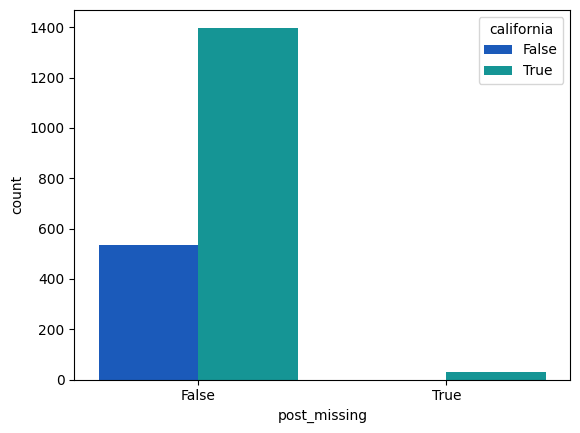

In [24]:
sns.countplot(x='post_missing', palette="winter", data=df, hue='california')

In [25]:
df.to_csv(f"{PATH_MMSEG_DATASET}/012_seed{SEED}.csv", index=False, header=True)

In [26]:
df.head(10)

,name,feature,mask,defects,fold,hight,width,california,pre_missing,post_missing,ratio,cv
0,cdd9e3a0-5030-49a8-ab76-4469381ee966_0,../data/002_Full+California/img/cdd9e3a0-5030-...,../data/002_Full+California/ann/cdd9e3a0-5030-...,False,-1,512,512,True,False,False,0.0,0
1,cdd9e3a0-5030-49a8-ab76-4469381ee966_1,../data/002_Full+California/img/cdd9e3a0-5030-...,../data/002_Full+California/ann/cdd9e3a0-5030-...,False,-1,512,512,True,False,False,0.0,3
2,cdd9e3a0-5030-49a8-ab76-4469381ee966_10,../data/002_Full+California/img/cdd9e3a0-5030-...,../data/002_Full+California/ann/cdd9e3a0-5030-...,False,-1,512,512,True,False,False,0.0,0
3,cdd9e3a0-5030-49a8-ab76-4469381ee966_100,../data/002_Full+California/img/cdd9e3a0-5030-...,../data/002_Full+California/ann/cdd9e3a0-5030-...,False,-1,512,512,True,False,False,0.0,1
4,cdd9e3a0-5030-49a8-ab76-4469381ee966_101,../data/002_Full+California/img/cdd9e3a0-5030-...,../data/002_Full+California/ann/cdd9e3a0-5030-...,False,-1,512,512,True,False,False,0.0,3
5,cdd9e3a0-5030-49a8-ab76-4469381ee966_102,../data/002_Full+California/img/cdd9e3a0-5030-...,../data/002_Full+California/ann/cdd9e3a0-5030-...,False,-1,512,512,True,False,False,0.0,3
6,cdd9e3a0-5030-49a8-ab76-4469381ee966_103,../data/002_Full+California/img/cdd9e3a0-5030-...,../data/002_Full+California/ann/cdd9e3a0-5030-...,False,-1,512,512,True,False,False,0.0,3
7,cdd9e3a0-5030-49a8-ab76-4469381ee966_104,../data/002_Full+California/img/cdd9e3a0-5030-...,../data/002_Full+California/ann/cdd9e3a0-5030-...,False,-1,512,512,True,False,False,0.0,0
8,cdd9e3a0-5030-49a8-ab76-4469381ee966_105,../data/002_Full+California/img/cdd9e3a0-5030-...,../data/002_Full+California/ann/cdd9e3a0-5030-...,False,-1,512,512,True,False,False,0.0,2
9,cdd9e3a0-5030-49a8-ab76-4469381ee966_106,../data/002_Full+California/img/cdd9e3a0-5030-...,../data/002_Full+California/ann/cdd9e3a0-5030-...,False,-1,512,512,True,False,False,0.0,0
